In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import f1_score
from sklearn.datasets import make_classification
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import SGD

import xgboost as xgb

from ucimlrepo import fetch_ucirepo 

import matplotlib.pyplot as plt
import seaborn as sns

/var/folders/wq/8mxmhthx1qjg6pq5jr3045k40000gn/T/ipykernel_94295/1549026588.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Iris Dataset

In [2]:
iris = fetch_ucirepo(id=53)

features = iris.data.features 
classes = iris.data.targets

# Encode classes into integers for modeling
classes['encoded_classes'] = pd.factorize(classes['class'])[0]

iris_df = pd.concat([features, classes], axis=1)

/var/folders/wq/8mxmhthx1qjg6pq5jr3045k40000gn/T/ipykernel_94295/335658641.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  classes['encoded_classes'] = pd.factorize(classes['class'])[0]


In [3]:
iris_df

,sepal length,sepal width,petal length,petal width,class,encoded_classes
0,5.1,3.5,1.4,0.2,Iris-setosa,0
1,4.9,3.0,1.4,0.2,Iris-setosa,0
2,4.7,3.2,1.3,0.2,Iris-setosa,0
3,4.6,3.1,1.5,0.2,Iris-setosa,0
4,5.0,3.6,1.4,0.2,Iris-setosa,0
...,...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,Iris-virginica,2
146,6.3,2.5,5.0,1.9,Iris-virginica,2
147,6.5,3.0,5.2,2.0,Iris-virginica,2
148,6.2,3.4,5.4,2.3,Iris-virginica,2


### Brief EDA

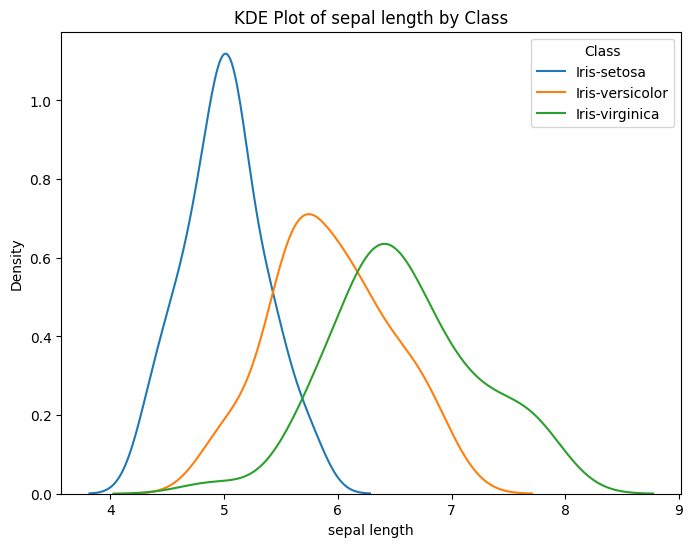

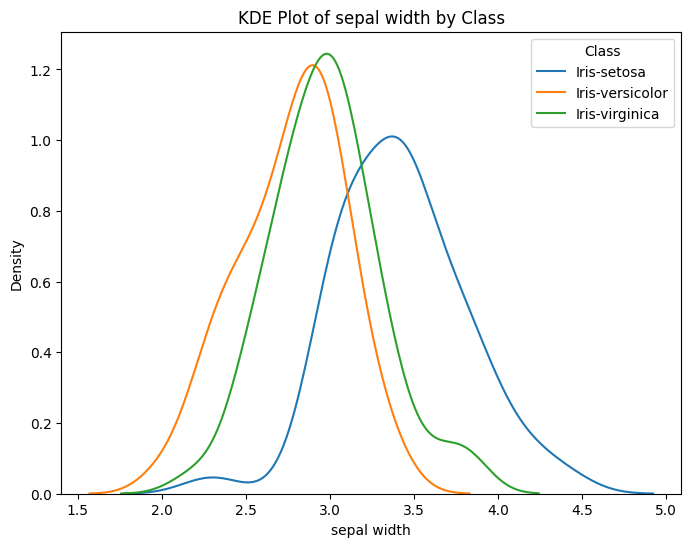

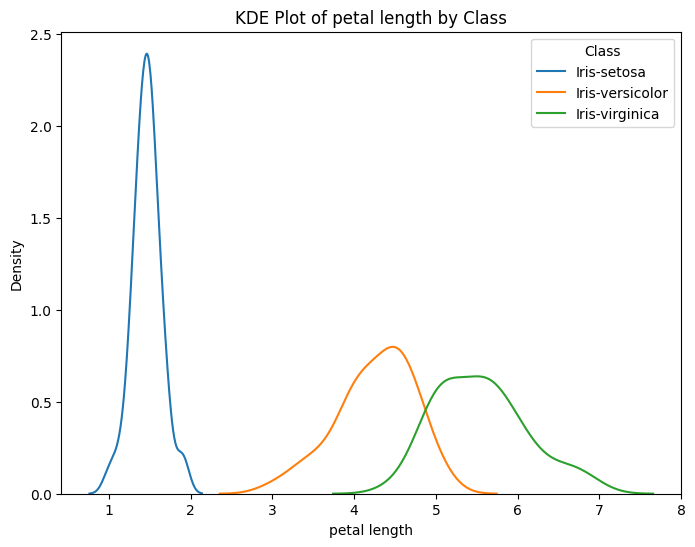

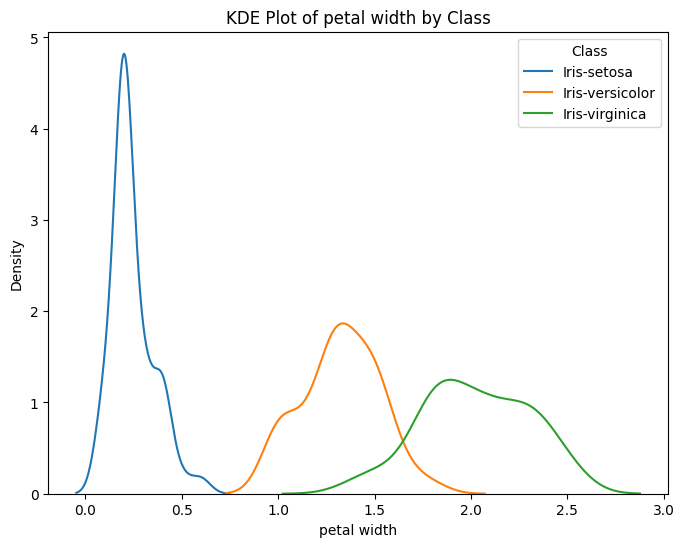

In [4]:
# List of columns to plot
columns_to_plot = ['sepal length', 'sepal width', 'petal length', 'petal width']

# Create separate KDE plots for each column and each class
for column in columns_to_plot:
    plt.figure(figsize=(8, 6))  # Set figure size for each plot
    for category, group in iris_df.groupby('class'):
        sns.kdeplot(group[column], label=category)

    plt.xlabel(column)
    plt.ylabel('Density')
    plt.legend(title='Class')
    plt.title(f'KDE Plot of {column} by Class')
    plt.show()

# Build A Neural Network Model with Torch

In [5]:
class nnModel(nn.Module):
    # A neural network model with 4 input features, 2 hidden layers and 3 output classes
    def __init__(self, features = 4, hidden_layer_1=10, hidden_layer_2=10, out_features=3):
        super().__init__() # instantiate the model
        self.fully_connected_1 = nn.Linear(features, hidden_layer_1)
        self.fully_connected_2 = nn.Linear(hidden_layer_1, hidden_layer_2)
        self.out = nn.Linear(hidden_layer_2, out_features)

    def forward_pass(self, x):
        x = F.relu(self.fully_connected_1(x))
        x = F.relu(self.fully_connected_2(x))
        x = self.out(x)

        return x
        

## Instantiate Model and Set a Random Seed

In [6]:
torch.manual_seed(16)
naive_model= nnModel()

In [7]:
torch.manual_seed(20)
model= nnModel()

### Naive Model Randomly Initialized Parameters

In [8]:
# Show the randomly seeded weights and biases for the first hidden layer
naive_model.fully_connected_1.__dict__['_parameters']

OrderedDict([('weight',
              Parameter containing:
              tensor([[-0.3375,  0.1240,  0.4298, -0.2441],
                      [ 0.4796, -0.4941,  0.1741,  0.1338],
                      [-0.1534, -0.1572, -0.3913, -0.1003],
                      [-0.1861, -0.1214,  0.4152,  0.1507],
                      [-0.4968, -0.2986,  0.3988, -0.0065],
                      [-0.1976,  0.2817,  0.4660, -0.3518],
                      [ 0.4960, -0.1327,  0.0638, -0.4031],
                      [-0.4280, -0.3742, -0.3673, -0.4863],
                      [-0.1677,  0.0529,  0.3516,  0.2177],
                      [-0.4441,  0.3859, -0.1125, -0.4916]], requires_grad=True)),
             ('bias',
              Parameter containing:
              tensor([ 0.4450, -0.3710,  0.4279,  0.3215, -0.4897, -0.1943,  0.3369,  0.0350,
                       0.0290, -0.2646], requires_grad=True))])

## Split Data into Training and Testing Sets and Construct Tensors

In [9]:
# Using the .values functon to convert pandas dataframes to numpy arrays (torch tensors don't like pandas dfs I guess)
X_train, X_test, y_train, y_test = train_test_split(features.values, classes.encoded_classes.values, test_size=0.2)

X_train_tensor = torch.FloatTensor(X_train)
X_test_tensor = torch.FloatTensor(X_test)
y_train_tensor = torch.LongTensor(y_train)
y_test_tensor = torch.LongTensor(y_test)

In [10]:
# Use Cross Entropy because outputs of ArgMax for classification are "probabilities"
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr = 0.01)

#Train the model
epochs = 50
losses = []

for i in range(epochs):

    soft_max = torch.nn.Softmax(dim = 1)
    
    y_pred_sm = soft_max(model.forward_pass(X_train_tensor))
    y_pred = model.forward_pass(X_train_tensor)

    # Measure loss
    loss = loss_function(y_pred_sm, y_train_tensor)

    losses.append(loss.detach().numpy())

    # Back propogation
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

Text(0.5, 0, 'Epoch')

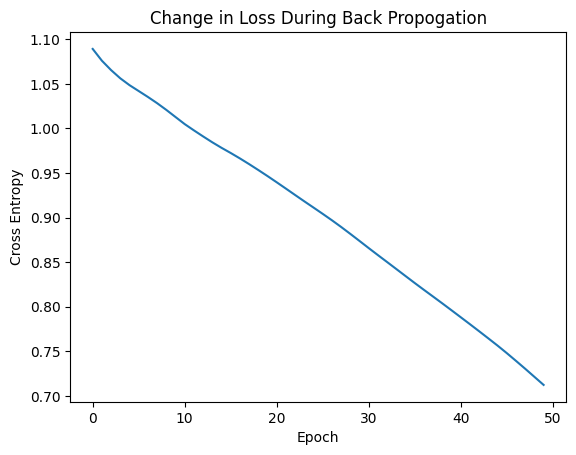

In [11]:
plt.plot(range(epochs), losses)
plt.title('Change in Loss During Back Propogation')
plt.ylabel('Cross Entropy')
plt.xlabel('Epoch')

### The Trained and Optimized Model Parameters

In [12]:
model.fully_connected_1.__dict__['_parameters']

OrderedDict([('weight',
              Parameter containing:
              tensor([[-0.0277, -0.4083,  0.2151, -0.2752],
                      [-0.4495, -0.0169,  0.7185,  0.0497],
                      [-0.3123,  0.4310, -0.4101, -0.1844],
                      [ 0.6760, -0.1887,  0.6281,  0.3827],
                      [-0.0644, -0.0570,  0.1257, -0.4621],
                      [ 0.1720, -0.3913,  0.7386,  0.0521],
                      [-0.1720, -0.4393,  0.5165,  0.7158],
                      [-0.1476,  0.1631, -0.2232, -0.5349],
                      [ 0.5860,  0.1829, -0.3265, -0.5609],
                      [-0.2601, -0.0218, -0.2697,  0.1451]], requires_grad=True)),
             ('bias',
              Parameter containing:
              tensor([-0.0192, -0.1774, -0.3566,  0.2548,  0.2918, -0.7186,  0.0631, -0.2698,
                       0.0338, -0.4183], requires_grad=True))])

## Test and Evaluate

In [13]:
# Run the test data through the untrained model
with torch.no_grad():
    
    y_val_naive = torch.argmax(naive_model.forward_pass(X_test_tensor), dim=1).detach().numpy()

# Use the trained model
with torch.no_grad():
    
    y_val = torch.argmax(model.forward_pass(X_test_tensor), dim=1).detach().numpy()


## F1 Accuracy of the Untrained Model vs. a Model Trained with 50 iterations (epochs)

In [14]:
print(f'Accuracy = {round(f1_score(y_test, y_val_naive, average='weighted'), 3) * 100} %')

Accuracy = 29.7 %


In [15]:
print(f'Accuracy = {round(f1_score(y_test, y_val, average='weighted'), 3) * 100} %')

Accuracy = 100.0 %


# Build an XGBoost Model with sklearn

## Split Data into Training and Testing Sets
Note: because this is a highly curated dataset and because we have already encoded the target class, we don't need to do any more data preprocessing. There is no missing data and all data type in the feature vector are numeric so no imputation or further encoding is needed.

If imbalance is an issue, try using `scale_pos_weight` parameter in model class

In [16]:
# Using the .values functon to convert pandas dataframes to numpy arrays
X_train2, X_test2, y_train2, y_test2 = train_test_split(
    features.values, classes.encoded_classes.values, test_size=0.2) #No need to stratify since the target data is balanced

In [17]:
clf_xgb = xgb.XGBClassifier(objective='binary:logistic',
                            missing=1,
                            eval_metric='aucpr', #use AUC to evaluate classification
                            early_stopping_rounds=10, #when the prediction stops improving significantly, 10 more trees will be built and if those don't improve the preds, the algorithm stops
                            seed = 67)

In [18]:
#Create a forest of XGB trees
clf_xgb.fit(X_train2,
            y_train2,
            verbose=True, #print out steps in the process
            eval_set=[(X_test2, y_test2)])

[0]	validation_0-aucpr:0.98807
[1]	validation_0-aucpr:0.98807
[2]	validation_0-aucpr:0.98807
[3]	validation_0-aucpr:0.98807
[4]	validation_0-aucpr:0.98807
[5]	validation_0-aucpr:0.98807
[6]	validation_0-aucpr:0.98807
[7]	validation_0-aucpr:0.99221
[8]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.99615
[10]	validation_0-aucpr:0.99615
[11]	validation_0-aucpr:0.99615
[12]	validation_0-aucpr:0.99615
[13]	validation_0-aucpr:0.99615
[14]	validation_0-aucpr:0.99509
[15]	validation_0-aucpr:0.99509
[16]	validation_0-aucpr:0.99509
[17]	validation_0-aucpr:0.99509
[18]	validation_0-aucpr:1.00000
[19]	validation_0-aucpr:1.00000
[20]	validation_0-aucpr:1.00000
[21]	validation_0-aucpr:1.00000
[22]	validation_0-aucpr:1.00000
[23]	validation_0-aucpr:1.00000
[24]	validation_0-aucpr:1.00000
[25]	validation_0-aucpr:1.00000
[26]	validation_0-aucpr:1.00000
[27]	validation_0-aucpr:1.00000


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=10,
              enable_categorical=False, eval_metric='aucpr', feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=1, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

### Feature Importance
Petal length (feature 2) followed by petal width (feature 3) are the best predictors of Iris species

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

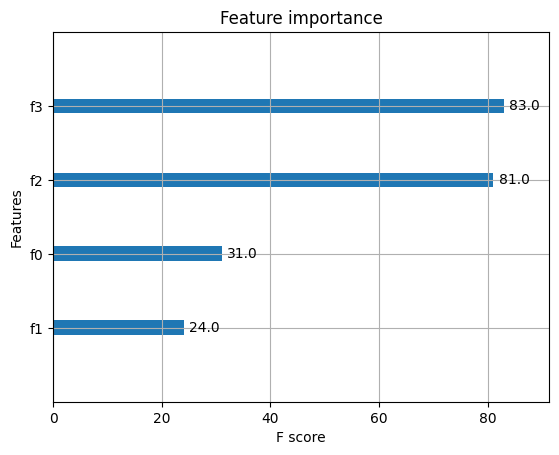

In [19]:
xgb.plot_importance(clf_xgb)

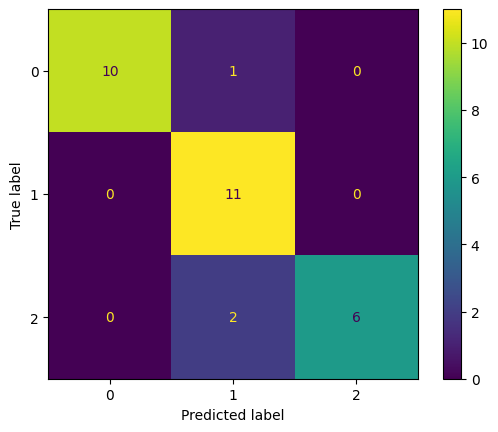

In [20]:
predictions = clf_xgb.predict(X_test2)
cm = confusion_matrix(y_test2, predictions, labels=clf_xgb.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=clf_xgb.classes_)
disp.plot()

plt.show()

In [21]:
print(f'Accuracy = {round(f1_score(y_test2, predictions, average='weighted'), 3) * 100} %')

Accuracy = 90.0 %


## The Model is Already Pretty Good But Let's do some Hyperparameter Optimization Just to Show How

Let's try optimizing `max_depth`, `learning_rate`, `gamma`, and `reg_lambda` with grid search optimization

In [22]:
param_grid = {
    'max_depth':list(range(0,10,1)),
    'learning_rate':list(np.linspace(0,1,10)),
    'gamma':list(np.linspace(0,1,10)),
    'reg_lambda':list(range(0,10,1))}

optimal_params = GridSearchCV(
    estimator=xgb.XGBClassifier(objective='binary:logistic',
                            missing=1,
                            eval_metric='aucpr', #use AUC to evaluate classification
                            early_stopping_rounds=10, #when the prediction stops improving significantly, 10 more trees will be built and if those don't improve the preds, the algorithm stops
                            seed = 67),
    param_grid=param_grid,
    scoring='roc_auc',
    verbose=False,
    n_jobs=10,
    cv=3)

optimal_params.fit(X_train2,
                y_train2,
                verbose=True, #print out steps in the process
                eval_set=[(X_test2, y_test2)])

[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[10]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	val

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[2]	vali

recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-

validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.97925
[6]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.97925
[14]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[15]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98304
[16]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98304
[17]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.98304
[18]	validation_0-aucpr:0.98304
[19]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.89675
[1]	validation_0-aucpr:0.89976
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.92287
[11]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.99221
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.99221
[0]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98654
[0

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92036
[4]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.90646
[0]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.90646
[5]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.90646
[3]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.90646
[10]	validation_0-aucpr:0.90646
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[9]	val

-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/utils/_param_validation.py", line 213, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_ranking.py", line 633, in roc_auc_score
    raise ValueError("multi_class must be in ('ovo', 'ovr')")
ValueError: multi_class must be in ('ovo', 'ovr')

  warnings.warn(
/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most 

[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.91725
[7]	validation_0-aucpr:0.90947
[9]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.90646
[9]	validation_0-aucpr:0.90646
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.88346
[1]	validation_0-aucpr:0.97292
[2]	validation_0-aucpr:0.97859
[3]	validation_0-aucpr:0.97925
[8]	validation_0-aucpr:0.98654
[4]	vali

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

aucpr:0.98304
[2]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.96772
[0]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.97083
[1]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.99090
[9]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.97971
[14]	validation_0-aucpr:0.98997
[14]	validation

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.90068
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.98430
[8]	validation_0-aucpr:0.98430
[9]	validation_0-aucpr:0.98430
[7]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.98430
[1]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.97083
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92036
[9]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.90646
[1]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.90646
[10]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.90646
[2]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.90566
[11]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.90068
[10]	validation_0-aucpr:0.90068
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



idation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.92287
[11]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.89675
[12]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.89675
[13]	validation_0-aucpr:0.97616
[0]	validation_0-aucpr:0.99221
[2]	validation_0-aucpr:0.92287
[14]	validation_0-aucpr:0.97616
[3]	validation_0-aucpr:0.92287
[15]	validation_0-aucpr:0.97616
[1]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.99221
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98654
[11]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.88346
[1]	validation_0-aucpr:0.97292
[2]	validation_0-aucpr:0.97859
[3]	val

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[8]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98430
[10]	validation_0-aucpr:0.99221
[11]	validation_0-aucpr:0.98654
[12]	validation_0-aucpr:0.99221
[8]	validation_0-aucpr:0.98430
[13]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98430
[14]	validation_0-aucpr:0.99221
[10]	validation_0-aucpr:0.98430
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92036
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.93613
[6]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.93613
[7]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.93613
[1]	validation_0-aucpr:0.93613
[8

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.99221
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98430
[1]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.98430
[2]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92036
[6]	validation_0-aucpr:0.92036
[10]	va

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

7616
[8]	validation_0-aucpr:0.97947
[9]	validation_0-aucpr:0.97947
[0]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.97892
[1]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.94500
[2]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.97580
[3]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.97580
[4]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.97580
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98015
[4]	validation_0-aucpr:0.97580
[7]	validation_0-aucpr:0.97628
[5]	validation_0-aucpr:0.97580
[6]	validation_0-aucpr:0.97580
[8]	validation_0-aucpr:0.97628
[7]	validation_0-aucpr:0.96240
[9]	validation_0-aucpr:0.97628
[8]	validation_0-aucpr:0.99246
[9]	validation_0-aucpr:0.99246
[10]	validation_0-aucpr:0.99246
[11]	validation_0-aucpr:0.99246
[12]	validation_0-aucpr:0.99246
[13]	validation_0-aucpr:0.99246
[14]	validation_0-aucpr:0.99246
[15]	validation_0-aucpr:0.99246
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.90

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[3]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.88346
[4]	validation_0-aucpr:0.92036
[1]	validation_0-aucpr:0.97292
[2]	validation_0-aucpr:0.99221
[3]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.92036
[4]	validation_0-aucpr:0.97358
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.99221
[7]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.92036
[0]	validation_0-aucpr:0.99221
[8]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.99615
[2]	validation_0-aucpr:0.98654
[11]	validation_0-aucpr:0.99090
[7]	validation_0-aucpr:0.92036
[12]	validation_0-aucpr:0.99615
[3]	validation_0-aucpr:0.98654
[13]	validation_0-aucpr:0.98953
[4]	validation_0-aucpr:0.98654
[14]	validation_0-aucpr:0.99509
[15]	validation_0-aucpr:0.98953
[5]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.90947
[16]	validation_0-aucpr:0.98953
[6]	validation_0-aucpr:0.98654
[17]	validation_0-aucpr:0.98953
[18]	validation_0-aucpr:0.98953

recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-

[2]	validation_0-aucpr:0.98304
[13]	validation_0-aucpr:0.98953
[14]	validation_0-aucpr:0.98953
[3]	validation_0-aucpr:0.97642
[4]	validation_0-aucpr:0.97642
[5]	validation_0-aucpr:0.97642
[15]	validation_0-aucpr:0.98953
[6]	validation_0-aucpr:0.97540
[7]	validation_0-aucpr:0.97540
[16]	validation_0-aucpr:0.98953
[8]	validation_0-aucpr:0.97540
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98304
[17]	validation_0-aucpr:0.98953
[2]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.97892
[3]	validation_0-aucpr:0.97642
[10]	validation_0-aucpr:0.97892
[4]	validation_0-aucpr:0.97642
[0]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.97642
[1]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.97540
[7]	validation_0-aucpr:0.97540
[2]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.97540
[3]	validation_0-aucpr:0.90947
[4]	validation_0-aucpr:0.90947
[9]	validation_0-aucpr:0.97892
[5]	validation_0-aucpr:0.90449
[6]	validation_0-aucpr:0.90449
[7]	validation_0-aucpr:0.90449
[8

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.90947
[2]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.90947
[2]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.90947
[3]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.90947
[4]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.90947
[5]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.90947
[6]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.90947
[7]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.92036
[9]	validation_0-aucpr:0.91469
[4]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92036
[5]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.91469
[9]	validation_0-aucpr:0.90449
[6]	validation_0-aucpr:0.98304
[7]	vali

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.88346
[1]	validation_0-aucpr:0.97292
[2]	validation_0-aucpr:0.97358
[3]	validation_0-aucpr:0.99221
[0]	validation_0-aucpr:0.99221
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98430
[13]	validation_0-aucpr:0.99509
[4]	validation_0-aucpr:0.98430
[5]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.90947
[6]	validation_0-aucpr:0.99509
[4]	validation_0-aucpr:0.90947
[7]	validation_0-aucpr:0.99509
[5]	validation_0-aucpr:0.90947
[0]	validation_0-aucpr:0.99221
[8]	validation_0-aucpr:0.99509
[9]	validation_0-aucpr:0.99509
[6]	validation_0-aucpr:0.90449
[1]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.99509
[7]	validation_0-aucpr:0.90449
[8]	validation_0-aucpr:0.90449
[2]	validation_0-aucpr:0.98654
[11]	validation_0-aucpr:0.99509
[12]	validation_0-aucpr:0.99509
[9]	validation_0-aucpr:0.90449
[3]	validation_0-aucpr:0.98430
[13]

s = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/utils/_param_validation.py", line 213, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hack


[6]	validation_0-aucpr:0.99509
[12]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.99509
[8]	validation_0-aucpr:0.98654
[14]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.99509
[15]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.99509
[16]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.99509
[11]	validation_0-aucpr:0.99509
[9]	validation_0-aucpr:0.98654
[12]	validation_0-aucpr:0.99509
[13]	validation_0-aucpr:0.99509
[14]	validation_0-aucpr:0.99509
[15]	validation_0-aucpr:0.99509
[0]	validation_0-aucpr:0.96772
[10]	validation_0-aucpr:0.98654
[16]	validation_0-aucpr:0.99509
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[3]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.88544
[0]	validation_0-aucpr:0.87012
[1]	validation_0-aucpr:0.88223
[2]	validation_0-aucpr:0.88223
[4]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.89401
[0]	validation_0-aucpr:0.88346
[4]	validation_0-aucpr:0.89401
[0]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.88544
[6]	validation_0-aucpr:0.88544
[7]	validation_0-aucpr:0.88544
[8]	validation_0-aucpr:0.88544
[9]	validation_0-aucpr:0.88544
[10]	validation_0-aucpr:0.88544
[11]	validation_0-aucpr:0.88544
[12]	validation_0-aucpr:0.88544
[1]	validation_0-aucpr:0.97083
[1]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.88544
[2]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.88544
[3]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.88544
[9]	validation_0-aucpr:0.88544
[4]	validation_0-aucpr:0.97083
[10]	validation_0-aucpr:0.88544
[5]	validation_0-aucpr:0.97083
[11]	validation_0-aucpr:0.88544
[12]	validation_0-aucpr:0.88544
[2

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[2]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.90947
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.90947
[5]	validation_0-aucpr:0.98997
[6]	validation_0-aucpr:0.90947
[6]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.90947
[7]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.90947
[8]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.90947
[9]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.90947
[10]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.98997
[14]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.99090
[3

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[3]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.97642
[4]	validation_0-aucpr:0.90947
[4]	validation_0-aucpr:0.97642
[5]	validation_0-aucpr:0.90947
[5]	validation_0-aucpr:0.97642
[6]	validation_0-aucpr:0.90947
[6]	validation_0-aucpr:0.97642
[7]	validation_0-aucpr:0.90947
[7]	validation_0-aucpr:0.97642
[8]	validation_0-aucpr:0.90947
[8]	validation_0-aucpr:0.97642
[9]	validation_0-aucpr:0.90947
[9]	validation_0-aucpr:0.97642
[10]	validation_0-aucpr:0.97642
[0]	validation_0-aucpr:0.87012
[1]	validation_0-aucpr:0.88223
[2]	validation_0-aucpr:0.88223
[3]	validation_0-aucpr:0.89401
[4]	validation_0-aucpr:0.89461
[5]	validation_0-aucpr:0.89461
[15]	validation_0-aucpr:0.97892
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.99509
[0]	va

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.88346
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98997
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.90947
[4]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.90947
[5]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.90947
[6]	validation_0-aucpr:0.98997
[6]	validation_0-aucpr:0.90947
[7]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.90947
[3]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.99615
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.90947
[5]	validation_0-aucpr:0.99509
[6]	validation_0-aucpr:0.98953
[9]	validation_0-aucpr:0.90947
[7]	validation_0-aucpr:0.99509
[8]	

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-pa

	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98997
[0]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.98997
[14]	validation_0-aucpr:0.98997
[1]	validation_0-aucpr:0.98654
[15]	validation_0-aucpr:0.98997
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98997
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98997
[0]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.98997
[7]	v

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.87012
[1]	validation_0-aucpr:0.88223
[6]	va

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[7]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[10]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[7]	val

learn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/utils/_param_validation.py", line 213, in wrapper
    return func(*args, **kwa

alidation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.98304
[13]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.99221
[14]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98654
[15]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[16]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98654
[17]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98304
[10]	va

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[2]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.99221
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.97083
[3]	validation_0-aucpr:0.97083
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.97083
[4]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.97083
[0]	val

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[0]	validation_0-aucpr:0.88346
[1]	validation_0-aucpr:0.99221
[2]	validation_0-aucpr:0.97859
[3]	validation_0-aucpr:0.99221
[4]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.99221
[0]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.97925
[7]	validation_0-aucpr:0.97925
[8]	validation_0-aucpr:0.97925
[1]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.97925
[10]	validation_0-aucpr:0.97925
[2]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.99221
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.99221
[6]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.99221
[8]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.99221
[10]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	va

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

ion_0-aucpr:0.97083
[3]	validation_0-aucpr:0.99221
[8]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.99221
[7]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.96772
[10]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.96772
[0]	validation_0-aucpr:0.88346
[4]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.97083
[5]	validation_0-aucpr:0.96772
[2]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.96772
[5]	validation_0-a

eback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.v

[0]	validation_0-aucpr:0.99221
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.99221
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.99221
[7]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[5]	vali

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[10]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.91673
[1]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92036
[2]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.90947
[3]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.90947
[7]	val

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

n_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.99090
[1]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.99090
[8]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.88346
[1]	validation_0-aucpr:0.97083
[2]	validation_0-aucpr:0.97083
[3]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.97083
[2]	validation_0-aucpr:0.97083
[4]	validation_0-aucpr:0.97083
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[5]	validation_0-au

                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/utils/_param_validation.py", line 213, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_ranking.py", line 633, in roc_auc_score
    raise ValueError("multi_class must be in ('ovo', 'ovr')")
ValueError: multi_class must be in ('ovo', 'ovr')

  warnings.warn(
/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_sele

[0]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.88346
[2]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.97292
[2]	validation_0-aucpr:0.97358
[3]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.99221
[4]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98304
[5]	vali

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.99221
[2]	validation_0-aucpr:0.99221
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.99090
[7]	validation_0-aucpr:0.99090
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.99090
[2]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.99090
[3]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.99090
[4]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98654
[2]	va

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[3]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.97992
[9]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.97992
[7]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.97992
[8]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98643
[8]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.98643
[9]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.98643
[11]	validation_0-aucpr:0.98643
[12]	validation_0-aucpr:0.98643
[10]	validation_0-aucpr:0.99615
[0]	validation_0-aucpr:0.99221
[13]	validation_0-aucpr:0.98643
[9]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98654
[14]	validation_0-aucpr:0.98643
[11]	validation_0-aucpr:0.99615
[15]	validation_0-aucpr:0.98643
[12]	validation_0-aucpr:0.99615
[16]	validation_0-aucpr:0.98643
[2]	validation_0-aucpr:0.98654
[13]	validation_0-aucpr:0.99615
[17]	validation_0-aucpr:0.98643
[14]	validation_0-aucpr:0.99615
[3]	validation_0-aucpr:0.9

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.97083
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98997
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.98997
[6]	validation_0-aucpr:0.98654
[11]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.98304
[12]	validation_0-aucpr:0.98997
[2]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98304
[13]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.98304
[14]	validation_0-aucpr:0.98997
[4]

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[11]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.99090
[12]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[13]	validation_0-aucpr:0.97358
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.99090
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.99090
[6]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.99090
[9]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.99221
[10]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.92287
[11]	validation_0-aucpr:0.98997
[10]	validation_0-aucpr:0.99090
[2]	validation_0-aucpr:0.98654
[12]	validation_0-aucpr:0.98997
[13]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.98654
[14]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.98654
[15]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.9865

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[2]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.94500
[3]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98430
[6]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.99509
[8]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.99509
[9]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.99509
[7]	validation_0-aucpr:0.99509
[8]	validation_0-aucpr:0.99509
[9]	validation_0-aucpr:0.99509
[10]	validation_0-aucpr:0.99509
[11]	validation_0-aucpr:0.99509
[12]	validation_0-aucpr:0.99509
[13]	validation_0-aucpr:0.99509
[14]	validation_0-aucpr:0.99509
[0]	validation_0-aucpr:0.94500
[1]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98430
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.99509
[5]	validation_0-aucpr:0.99509
[6]	validation_0-aucpr:0.99509
[1]	validation_0-aucpr:0.92287
[7]

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[5]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.97083
[4]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.97083
[10]	v

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site


[0]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98997
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98997
[2]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.98997
[3]	validation_0-aucpr:0.92036
[8]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.92036
[9]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.90947
[10]	validation_0-aucpr:0.98997
[6]	validation_0-aucpr:0.98997
[6]	validation_0-aucpr:0.90947
[11]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.90947
[12]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.98997
[8]	validation_0-aucpr:0.90947
[9]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.90947
[0]	validation_0-aucpr:0.99221
[10]	validation_0-aucpr:0.98997
[11]	validation_0-aucpr:0.98997
[12]	validation_0-aucpr:0.98997
[

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-pa

[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[10]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[5]	validation_0-aucpr:0.33333
[6]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[7]	validation_0-aucpr:0.33333
[8]	validation_0-aucpr:0.33333
[9]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.33333
[1]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.33333
[2]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.33333
[3]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[0]	validation_0-aucpr:0.33333
[4]	validation_0-aucpr:0.92287
[2]	val

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[4]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.94500
[5]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.96772
[2]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.97083
[2]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.96772
[5]	validation_0-aucpr:0.96772
[10]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.96772
[7]	validation_0-aucpr:0.97083
[3]	validation_0-aucpr:0.97083
[8]	val

ers/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 350, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/utils/_param_validation.py", line 213, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_ranking.py", line 633, in roc_auc_score
    raise ValueError("multi_class must be in ('ovo', 'ovr')")
ValueError: multi_class must be in ('ovo', 'ovr')

  warnings.warn(
/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-

[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[2]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.96772
[5]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.97083
[4]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.96772
[6]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.96772
[7]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.96772
[8]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.92287
[6]	vali

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[0]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.96772
[2]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.96772
[5]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.91673
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.97083
[11]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.92287
[12]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.99221
[13]	validation_0-aucpr:0.97083
[14]	validation_0-aucpr:0.97083
[1]	validation_0-aucpr:0.98654
[15]	validation_0-aucpr:0.97083
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[1

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.98304
[11]	validation_0-aucpr:0.98304
[12]	validation_0-aucpr:0.98304
[13]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.99221
[2]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98654
[5]

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.96772
[2]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.97083
[10]	validation_0-aucpr:0.97083
[11]	validation_0-aucpr:0.97083
[12]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.92287
[13]	validation_0-aucpr:0.97083
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.99221
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.98654
[5]	vali

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[3]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.96772
[5]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.97083
[10]	validation_0-aucpr:0.97083
[11]	validation_0-aucpr:0.97083
[12]	validation_0-aucpr:0.97083
[13]	validation_0-aucpr:0.97083
[14]	validation_0-aucpr:0.97083
[15]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.98304
[

etrics/_ranking.py", line 633, in roc_auc_score
    raise ValueError("multi_class must be in ('ovo', 'ovr')")
ValueError: multi_class must be in ('ovo', 'ovr')

  warnings.warn(
/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)


[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[0]	validation_0-aucpr:0.96772
[1]	validation_0-aucpr:0.96772
[2]	validation_0-aucpr:0.96772
[3]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.96772
[0]	validation_0-aucpr:0.99221
[5]	validation_0-aucpr:0.97083
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.99221
[6]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.97083
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[8]	validation_0-aucpr:0.97083
[6]	validation_0-aucpr:0.99221
[9]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.98654
[10]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.98654
[9]	validation_0-aucpr:0.98654
[11]	validation_0-aucpr:0.97083
[12]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.99221
[0]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[1]	validation_0-aucpr:0.98654
[3]	v

g.py", line 633, in roc_auc_score
    raise ValueError("multi_class must be in ('ovo', 'ovr')")
ValueError: multi_class must be in ('ovo', 'ovr')

  warnings.warn(
/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^

[5]	validation_0-aucpr:0.97292
[0]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.91673
[1]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.97292
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.97292
[3]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[4]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.97292
[2]	validation_0-aucpr:0.98304
[3]	validation_0-aucpr:0.98304
[4]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.98997
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.98997
[7]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.97292
[8]	validation_0-aucpr:0.98997
[9]	validation_0-aucpr:0.98997
[0]	validation_0-aucpr:0.99221
[10]	validation_0-aucpr:0.98997
[4]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.97292
[6]	validation_0-aucpr:0.92287
[11]	validation_0-aucpr:0.98997
[1]	validation_0-aucpr:0.98654
[5]	v

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

ation_0-aucpr:0.99090
[4]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.97083
[7]	validation_0-aucpr:0.99090
[5]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.97083
[8]	validation_0-aucpr:0.99090
[6]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.99090
[7]	validation_0-aucpr:0.92287
[10]	validation_0-aucpr:0.97083
[0]	validation_0-aucpr:0.88346
[10]	validation_0-aucpr:0.99090
[8]	validation_0-aucpr:0.92287
[11]	validation_0-aucpr:0.97083
[9]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98654
[3]	validation_0-aucpr:0.98654
[4]	validation_0-aucpr:0.98654
[5]	validation_0-aucpr:0.98654
[6]	validation_0-aucpr:0.98654
[7]	validation_0-aucpr:0.98654
[8]	validation

/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/sklearn/metrics/_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site

[8]	validation_0-aucpr:0.98304
[5]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98304
[10]	validation_0-aucpr:0.98304
[6]	validation_0-aucpr:0.98304
[7]	validation_0-aucpr:0.98304
[8]	validation_0-aucpr:0.98304
[9]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[7]	validation_0-aucpr:0.92287
[8]	validation_0-aucpr:0.92287
[9]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.92287
[1]	validation_0-aucpr:0.92287
[2]	validation_0-aucpr:0.92287
[3]	validation_0-aucpr:0.92287
[4]	validation_0-aucpr:0.92287
[5]	validation_0-aucpr:0.92287
[6]	validation_0-aucpr:0.92287
[0]	validation_0-aucpr:0.96772
[0]	validation_0-aucpr:0.99221
[1]	validation_0-aucpr:0.98304
[0]	validation_0-aucpr:0.98304
[1]	validation_0-aucpr:0.98654
[2]	validation_0-aucpr:0.98304
[2]	validation_0-aucpr:0.99221
[1]	val

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [23]:
print(optimal_params.best_params_)

{'gamma': 0.0, 'learning_rate': 0.0, 'max_depth': 0, 'reg_lambda': 0}


In [24]:
clf_xgb2 = xgb.XGBClassifier(objective='binary:logistic',
                            missing=1,
                            gamma=optimal_params.best_params_['gamma'],
                            learn_rate=optimal_params.best_params_['learning_rate'],
                            max_depth=optimal_params.best_params_['max_depth'],
                            reg_lambda=optimal_params.best_params_['reg_lambda'],
                            eval_metric='aucpr', #use AUC to evaluate classification
                            early_stopping_rounds=10, #when the prediction stops improving significantly, 10 more trees will be built and if those don't improve the preds, the algorithm stops
                            seed = 67)

#Create a forest of XGB trees
clf_xgb2.fit(X_train2,
            y_train2,
            verbose=True, #print out steps in the process
            eval_set=[(X_test2, y_test2)])

[0]	validation_0-aucpr:0.97561
[1]	validation_0-aucpr:0.99515
[2]	validation_0-aucpr:0.99515
[3]	validation_0-aucpr:0.99515
[4]	validation_0-aucpr:0.98689
[5]	validation_0-aucpr:0.98689
[6]	validation_0-aucpr:0.98689
[7]	validation_0-aucpr:0.98689
[8]	validation_0-aucpr:0.98689
[9]	validation_0-aucpr:0.98689
[10]	validation_0-aucpr:0.98689


/Users/ryangeygan/hacking/machine-learning/.venv-machine-learning/lib/python3.12/site-packages/xgboost/core.py:160: UserWarning: [14:24:48] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "learn_rate" } are not used.

  warnings.warn(smsg, UserWarning)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=10,
              enable_categorical=False, eval_metric='aucpr', feature_types=None,
              gamma=0.0, grow_policy=None, importance_type=None,
              interaction_constraints=None, learn_rate=0.0, learning_rate=None,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=0, max_leaves=None,
              min_child_weight=None, missing=1, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, ...)

## Optimization Improved the Accuracy

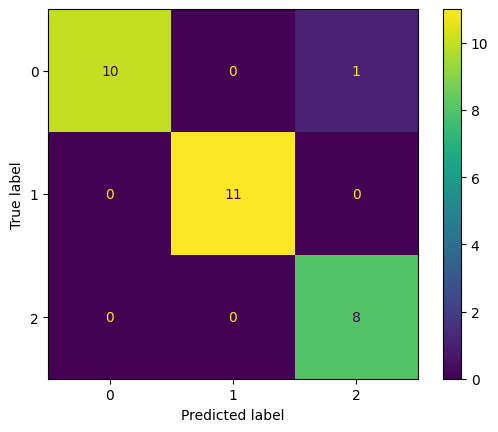

In [25]:
predictions2 = clf_xgb2.predict(X_test2)
cm = confusion_matrix(y_test2, predictions2, labels=clf_xgb2.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=clf_xgb2.classes_)
disp.plot()

plt.show()

In [26]:
print(f'Accuracy = {round(f1_score(y_test2, predictions2, average='weighted'), 3) * 100} %')

Accuracy = 96.7 %
